In [1]:
import torch
import cv2
import time
import pytesseract
import re
import numpy as np
import easyocr
import matplotlib.pyplot as plt
from PIL import Image
from IPython.display import display

In [2]:
EASY_OCR = easyocr.Reader(['en'])
OCR_TH = 0.05

In [3]:
def detectx (frame, model):
    frame = [frame]
    print(f"[INFO] Detecting. . . ")
    results = model(frame)

    labels, cordinates = results.xyxyn[0][:, -1], results.xyxyn[0][:, :-1]
    return labels, cordinates

In [45]:
def plot_boxes(results, frame,classes):
    
    labels, cord = results
    n = len(labels)
    x_shape, y_shape = frame.shape[1], frame.shape[0]

    print(f"[INFO] Total {n} detections. . . ")
    print(f"[INFO] Looping through all detections. . . ")


    for i in range(n):
        row = cord[i]
        if row[4] >= 0.30:
            print(f"[INFO] Extracting BBox coordinates. . . ")
            x1, y1, x2, y2 = int(row[0]*x_shape), int(row[1]*y_shape), int(row[2]*x_shape), int(row[3]*y_shape)
            text_d = classes[int(labels[i])]

            coords = [x1,y1,x2,y2]

            plate_num = recognize_plate_easyocr(img = frame, coords= coords, reader= EASY_OCR, region_threshold= OCR_TH)

            cv2.rectangle(frame, (x1, y1-50), (x2, y2), (0, 0, 255), 2)
            cv2.rectangle(frame, (x1, y1-50), (x2, y1), (0, 0, 255), -1)
            cv2.putText(frame, f"{plate_num[0]}", (x1, y1), cv2.FONT_HERSHEY_SIMPLEX, 2,(255,255,255), 2)

    return frame

In [46]:
def recognize_plate_easyocr(img, coords,reader,region_threshold):
    xmin, ymin, xmax, ymax = coords
    nplate = img[int(ymin):int(ymax), int(xmin):int(xmax)]


    ocr_result = reader.readtext(nplate)

    text = filter_text(region=nplate, ocr_result=ocr_result, region_threshold= region_threshold)

    if len(text)>=1:
        for i in range(len(text)):
            text[i] = text[i].upper()
    return text

In [47]:
def filter_text(region, ocr_result, region_threshold):
    rectangle_size = region.shape[0]*region.shape[1]
    
    plate = [] 
    print(ocr_result[0][1].upper())
    for result in ocr_result:
        length = np.sum(np.subtract(result[0][1], result[0][0]))
        height = np.sum(np.subtract(result[0][2], result[0][1]))
        
        if length*height / rectangle_size >=region_threshold:
            plate.append(result[1].upper())
    return plate

In [48]:
def main(img_path=None, vid_path=None,vid_out = None):

    print(f"[INFO] Loading model... ")
    model =  torch.hub.load("./yolov5", 'custom', source ='local', path='last.pt',force_reload=True) 

    classes = model.names

    if img_path != None:
        print(f"[INFO] Working with image: {img_path}")
        img_out_name = f"./output/result_{img_path.split('/')[-1]}"
        frame = cv2.imread(img_path)
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        results = detectx(frame, model=model)
        frame = cv2.cvtColor(frame, cv2.COLOR_RGB2BGR)
    
        frame = plot_boxes(results, frame, classes=classes)
        image = Image.fromarray(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
        display(image)
        cv2.imwrite(f"{img_out_name}", frame)
        print(f"[INFO] Image saved as: {img_out_name}")

    if vid_path != None:
        print(f"[INFO] Working with video: {vid_path}")

        cap = cv2.VideoCapture(vid_path)

        if vid_out:

            width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
            height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
            fps = int(cap.get(cv2.CAP_PROP_FPS))
            codec=cv2.VideoWriter_fourcc(*'MP4V')
            out = cv2.VideoWriter(vid_out, codec, fps, (width, height))

        assert cap.isOpened()
        frame_no = 1

        cv2.namedWindow("vid_out", cv2.WINDOW_NORMAL)
        while True:
            ret, frame = cap.read()
            if ret  and frame_no %1 == 0:
                print(f"[INFO] Working with frame {frame_no} ")

                frame = cv2.cvtColor(frame,cv2.COLOR_BGR2RGB)
                results = detectx(frame, model = model)
                frame = cv2.cvtColor(frame,cv2.COLOR_RGB2BGR)


                frame = plot_boxes(results, frame,classes = classes)
                
                cv2.imshow("vid_out", frame)
                if vid_out:
                    print(f"[INFO] Saving output video. . . ")
                    out.write(frame)

                if cv2.waitKey(5) & 0xFF == ord('q'):
                    break
                frame_no += 1
        
        print(f"[INFO] Cleaning up. . . ")
        out.release()
        
    cv2.destroyAllWindows()
    

YOLOv5  2022-11-12 Python-3.12.0 torch-2.3.1+cu121 CUDA:0 (NVIDIA GeForce GTX 1660 Ti with Max-Q Design, 6144MiB)



[INFO] Loading model... 


Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients
Adding AutoShape... 


[INFO] Working with image: license plate dataset test\IMG_20220913_133205.jpg
[INFO] Detecting. . . 
[INFO] Total 1 detections. . . 
[INFO] Looping through all detections. . . 
[INFO] Extracting BBox coordinates. . . 
TN66Z5995


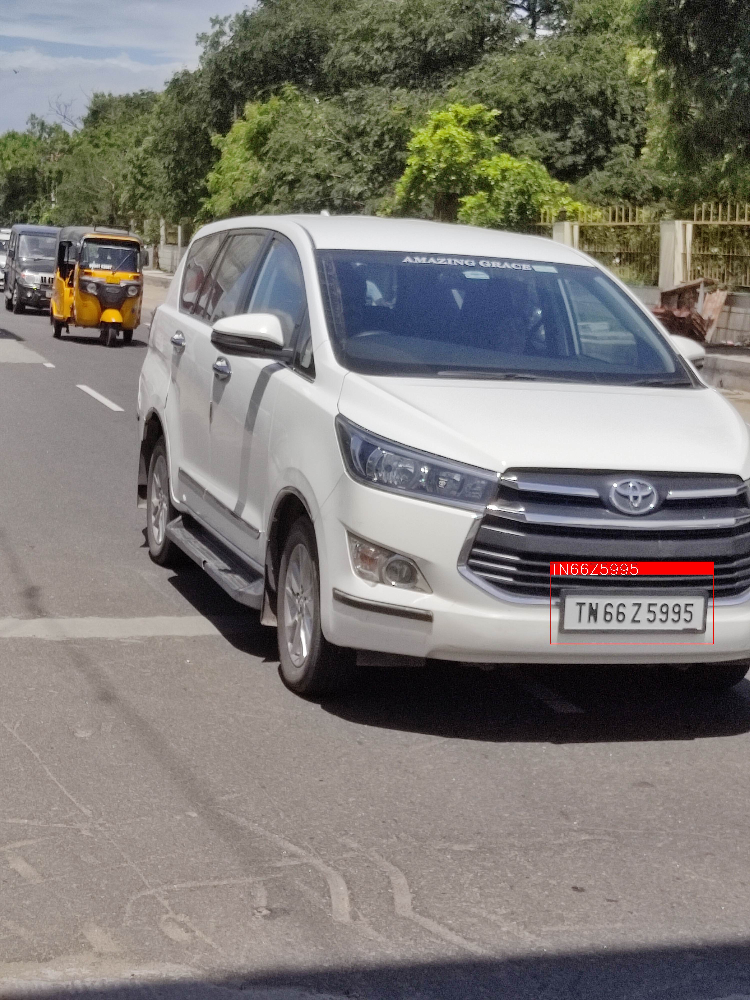

[INFO] Image saved as: ./output/result_license plate dataset test\IMG_20220913_133205.jpg


In [49]:
main(img_path=r"license plate dataset test\IMG_20220913_133205.jpg") 
#main(vid_path=0,vid_out="webcam_facemask_result.mp4")
#main(img_path=r"E:\License Plate Number recognition\train\images\frame-25.jpg") 